In [135]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import mpl_toolkits
from sklearn import preprocessing
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn import metrics
import graphviz
from sklearn.tree import DecisionTreeClassifier
%matplotlib inline

# Data exploring

In [136]:
soccer =pd.read_csv("Soccer.csv", encoding='ISO-8859-1')

In [137]:
soccer.head()

,ï»¿,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,...,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Release Clause
0,0,158023,L. Messi,31,https://cdn.sofifa.org/players/4/19/158023.png,Argentina,https://cdn.sofifa.org/flags/52.png,94,94,FC Barcelona,...,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,â¬226.5M
1,1,20801,Cristiano Ronaldo,33,https://cdn.sofifa.org/players/4/19/20801.png,Portugal,https://cdn.sofifa.org/flags/38.png,94,94,Juventus,...,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,â¬127.1M
2,2,190871,Neymar Jr,26,https://cdn.sofifa.org/players/4/19/190871.png,Brazil,https://cdn.sofifa.org/flags/54.png,92,93,Paris Saint-Germain,...,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,â¬228.1M
3,3,193080,De Gea,27,https://cdn.sofifa.org/players/4/19/193080.png,Spain,https://cdn.sofifa.org/flags/45.png,91,93,Manchester United,...,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,â¬138.6M
4,4,192985,K. De Bruyne,27,https://cdn.sofifa.org/players/4/19/192985.png,Belgium,https://cdn.sofifa.org/flags/7.png,91,92,Manchester City,...,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,â¬196.4M


In [138]:
soccer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18207 entries, 0 to 18206
Data columns (total 89 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   ï»¿                       18207 non-null  int64  
 1   ID                        18207 non-null  int64  
 2   Name                      18207 non-null  object 
 3   Age                       18207 non-null  int64  
 4   Photo                     18207 non-null  object 
 5   Nationality               18207 non-null  object 
 6   Flag                      18207 non-null  object 
 7   Overall                   18207 non-null  int64  
 8   Potential                 18207 non-null  int64  
 9   Club                      17966 non-null  object 
 10  Club Logo                 18207 non-null  object 
 11  Value                     18207 non-null  object 
 12  Wage                      18207 non-null  object 
 13  Special                   18207 non-null  int64  
 14  Prefer

In [139]:
soccer.describe()

,ï»¿,ID,Age,Overall,Potential,Special,International Reputation,Weak Foot,Skill Moves,Jersey Number,...,Penalties,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes
count,18207.000000,18207.000000,18207.000000,18207.000000,18207.000000,18207.000000,18159.000000,18159.000000,18159.000000,18147.000000,...,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000,18159.000000
mean,9103.000000,214298.338606,25.122206,66.238699,71.307299,1597.809908,1.113222,2.947299,2.361308,19.546096,...,48.548598,58.648274,47.281623,47.697836,45.661435,16.616223,16.391596,16.232061,16.388898,16.710887
std,5256.052511,29965.244204,4.669943,6.908930,6.136496,272.586016,0.394031,0.660456,0.756164,15.947765,...,15.704053,11.436133,19.904397,21.664004,21.289135,17.695349,16.906900,16.502864,17.034669,17.955119
min,0.000000,16.000000,16.000000,46.000000,48.000000,731.000000,1.000000,1.000000,1.000000,1.000000,...,5.000000,3.000000,3.000000,2.000000,3.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,4551.500000,200315.500000,21.000000,62.000000,67.000000,1457.000000,1.000000,3.000000,2.000000,8.000000,...,39.000000,51.000000,30.000000,27.000000,24.000000,8.000000,8.000000,8.000000,8.000000,8.000000
50%,9103.000000,221759.000000,25.000000,66.000000,71.000000,1635.000000,1.000000,3.000000,2.000000,17.000000,...,49.000000,60.000000,53.000000,55.000000,52.000000,11.000000,11.000000,11.000000,11.000000,11.000000
75%,13654.500000,236529.500000,28.000000,71.000000,75.000000,1787.000000,1.000000,3.000000,3.000000,26.000000,...,60.000000,67.000000,64.000000,66.000000,64.000000,14.000000,14.000000,14.000000,14.000000,14.000000
max,18206.000000,246620.000000,45.000000,94.000000,95.000000,2346.000000,5.000000,5.000000,5.000000,99.000000,...,92.000000,96.000000,94.000000,93.000000,91.000000,90.000000,92.000000,91.000000,90.000000,94.000000


In [140]:
soccer = soccer.drop(columns=['ï»¿','Photo','Nationality','Flag','Photo','Nationality','Flag','Club Logo','Real Face','Joined','Loaned From', 'Contract Valid Until','LS', 'ST', 'RS', 'LW', 'LF', 'CF', 'RF', 'RW', 'LAM', 'RAM','CAM','LCM','RM', 'LM', 'CM', 'RCM', 'LWB', 'LDM', 'CDM', 'RDM', 'RWB', 'LB', 'LCB', 'CB', 'RCB', 'RB','Release Clause']) 

In [141]:
soccer.head()

,ID,Name,Age,Overall,Potential,Club,Value,Wage,Special,Preferred Foot,...,Penalties,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes
0,158023,L. Messi,31,94,94,FC Barcelona,â¬110.5M,â¬565K,2202,Left,...,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0
1,20801,Cristiano Ronaldo,33,94,94,Juventus,â¬77M,â¬405K,2228,Right,...,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0
2,190871,Neymar Jr,26,92,93,Paris Saint-Germain,â¬118.5M,â¬290K,2143,Right,...,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0
3,193080,De Gea,27,91,93,Manchester United,â¬72M,â¬260K,1471,Right,...,40.0,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0
4,192985,K. De Bruyne,27,91,92,Manchester City,â¬102M,â¬355K,2281,Right,...,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0


In [142]:
soccer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18207 entries, 0 to 18206
Data columns (total 53 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   ID                        18207 non-null  int64  
 1   Name                      18207 non-null  object 
 2   Age                       18207 non-null  int64  
 3   Overall                   18207 non-null  int64  
 4   Potential                 18207 non-null  int64  
 5   Club                      17966 non-null  object 
 6   Value                     18207 non-null  object 
 7   Wage                      18207 non-null  object 
 8   Special                   18207 non-null  int64  
 9   Preferred Foot            18159 non-null  object 
 10  International Reputation  18159 non-null  float64
 11  Weak Foot                 18159 non-null  float64
 12  Skill Moves               18159 non-null  float64
 13  Work Rate                 18159 non-null  object 
 14  Body T

In [143]:
soccer.isnull().sum()

ID                            0
Name                          0
Age                           0
Overall                       0
Potential                     0
Club                        241
Value                         0
Wage                          0
Special                       0
Preferred Foot               48
International Reputation     48
Weak Foot                    48
Skill Moves                  48
Work Rate                    48
Body Type                    48
Position                     60
Jersey Number                60
Height                       48
Weight                       48
Crossing                     48
Finishing                    48
HeadingAccuracy              48
ShortPassing                 48
Volleys                      48
Dribbling                    48
Curve                        48
FKAccuracy                   48
LongPassing                  48
BallControl                  48
Acceleration                 48
SprintSpeed                  48
Agility 

In [144]:
soccer.Position.value_counts()

ST     2152
GK     2025
CB     1778
CM     1394
LB     1322
RB     1291
RM     1124
LM     1095
CAM     958
CDM     948
RCB     662
LCB     648
LCM     395
RCM     391
LW      381
RW      370
RDM     248
LDM     243
LS      207
RS      203
RWB      87
LWB      78
CF       74
RAM      21
LAM      21
RF       16
LF       15
Name: Position, dtype: int64

# Data vizualisation

Text(0, 0.5, 'Position Count')

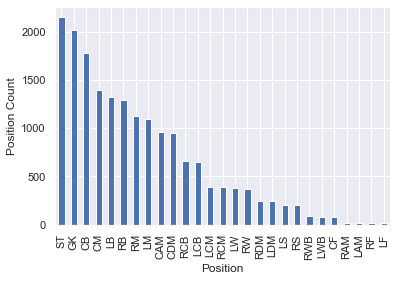

In [145]:
plt = soccer.Position.value_counts().plot(kind='bar')
plt.set_xlabel('Position')
plt.set_ylabel('Position Count')

In [146]:
soccer.rename(columns={'Work Rate': 'WorkRate', 'Preferred Foot': 'PreferredFoot','Body Type':'BodyType','Skill Moves':'SkillMoves','International Reputation': 'InternationalReputation', 'Weak Foot':'WeakFoot','Jersey Number':'JerseyNumber'}, inplace=True)

Text(0, 0.5, 'Work Rate Count')

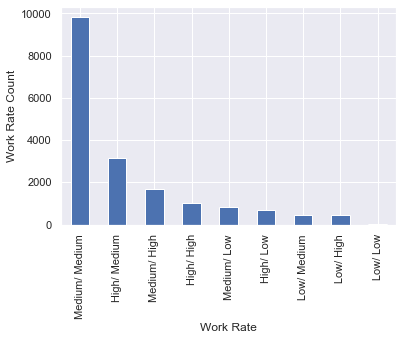

In [147]:
plt = soccer.WorkRate.value_counts().plot(kind='bar')
plt.set_xlabel('Work Rate')
plt.set_ylabel('Work Rate Count')

Text(0, 0.5, 'Preferred Foot count')

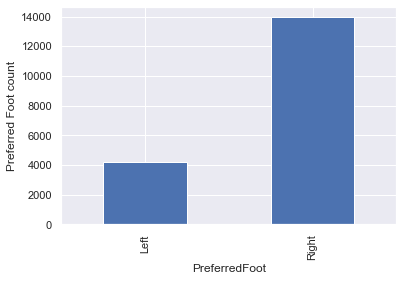

In [148]:
plt = soccer.PreferredFoot.value_counts().sort_index().plot(kind='bar', title='')
plt.set_xlabel('PreferredFoot')
plt.set_ylabel('Preferred Foot count')

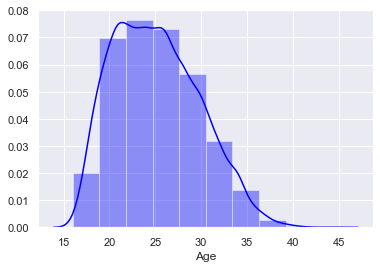

In [149]:
sns.distplot(soccer["Age"],bins=10,hist=True,kde=True,color="blue")

In [150]:
soccer["Weight"]

0        159lbs
1        183lbs
2        150lbs
3        168lbs
4        154lbs
          ...  
18202    134lbs
18203    170lbs
18204    148lbs
18205    154lbs
18206    176lbs
Name: Weight, Length: 18207, dtype: object

In [151]:
soccer['Weight'] = soccer['Weight'].str.replace(r'lbs', '')

In [152]:
soccer["Weight"] = soccer["Weight"].astype("float")

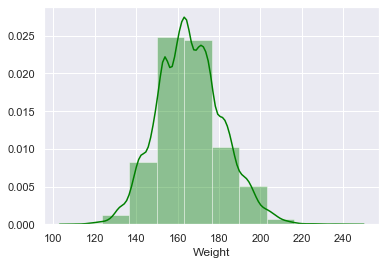

In [153]:
sns.distplot(soccer["Weight"],bins=10,hist=True,kde=True,color="green")

In [154]:
soccer["Height"]

0         5'7
1         6'2
2         5'9
3         6'4
4        5'11
         ... 
18202     5'9
18203     6'3
18204     5'8
18205    5'10
18206    5'10
Name: Height, Length: 18207, dtype: object

In [155]:
soccer['Height'] = soccer['Height'].str.replace(r"'", '.')

In [156]:
soccer["Height"] = soccer["Height"].astype("float")

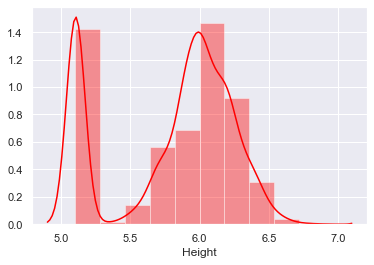

In [157]:
sns.distplot(soccer["Height"],bins=10,hist=True,kde=True,color="red")

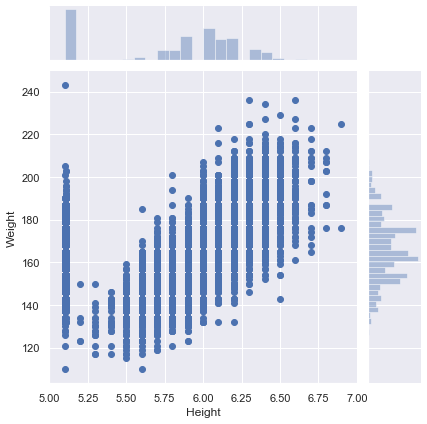

In [158]:
sns.jointplot(x='Height',y = 'Weight',data = soccer,kind = 'scatter')

In [159]:
soccer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18207 entries, 0 to 18206
Data columns (total 53 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   ID                       18207 non-null  int64  
 1   Name                     18207 non-null  object 
 2   Age                      18207 non-null  int64  
 3   Overall                  18207 non-null  int64  
 4   Potential                18207 non-null  int64  
 5   Club                     17966 non-null  object 
 6   Value                    18207 non-null  object 
 7   Wage                     18207 non-null  object 
 8   Special                  18207 non-null  int64  
 9   PreferredFoot            18159 non-null  object 
 10  InternationalReputation  18159 non-null  float64
 11  WeakFoot                 18159 non-null  float64
 12  SkillMoves               18159 non-null  float64
 13  WorkRate                 18159 non-null  object 
 14  BodyType              

In [160]:
soccer["Value"]

0        â¬110.5M
1           â¬77M
2        â¬118.5M
3           â¬72M
4          â¬102M
           ...    
18202       â¬60K
18203       â¬60K
18204       â¬60K
18205       â¬60K
18206       â¬60K
Name: Value, Length: 18207, dtype: object

In [161]:
soccer["Wage"]

0        â¬565K
1        â¬405K
2        â¬290K
3        â¬260K
4        â¬355K
          ...   
18202      â¬1K
18203      â¬1K
18204      â¬1K
18205      â¬1K
18206      â¬1K
Name: Wage, Length: 18207, dtype: object

In [162]:
soccer = soccer.drop(columns=['Value','Wage','ID','Name','Club','BodyType'])

In [163]:
soccer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18207 entries, 0 to 18206
Data columns (total 47 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Age                      18207 non-null  int64  
 1   Overall                  18207 non-null  int64  
 2   Potential                18207 non-null  int64  
 3   Special                  18207 non-null  int64  
 4   PreferredFoot            18159 non-null  object 
 5   InternationalReputation  18159 non-null  float64
 6   WeakFoot                 18159 non-null  float64
 7   SkillMoves               18159 non-null  float64
 8   WorkRate                 18159 non-null  object 
 9   Position                 18147 non-null  object 
 10  JerseyNumber             18147 non-null  float64
 11  Height                   18159 non-null  float64
 12  Weight                   18159 non-null  float64
 13  Crossing                 18159 non-null  float64
 14  Finishing             

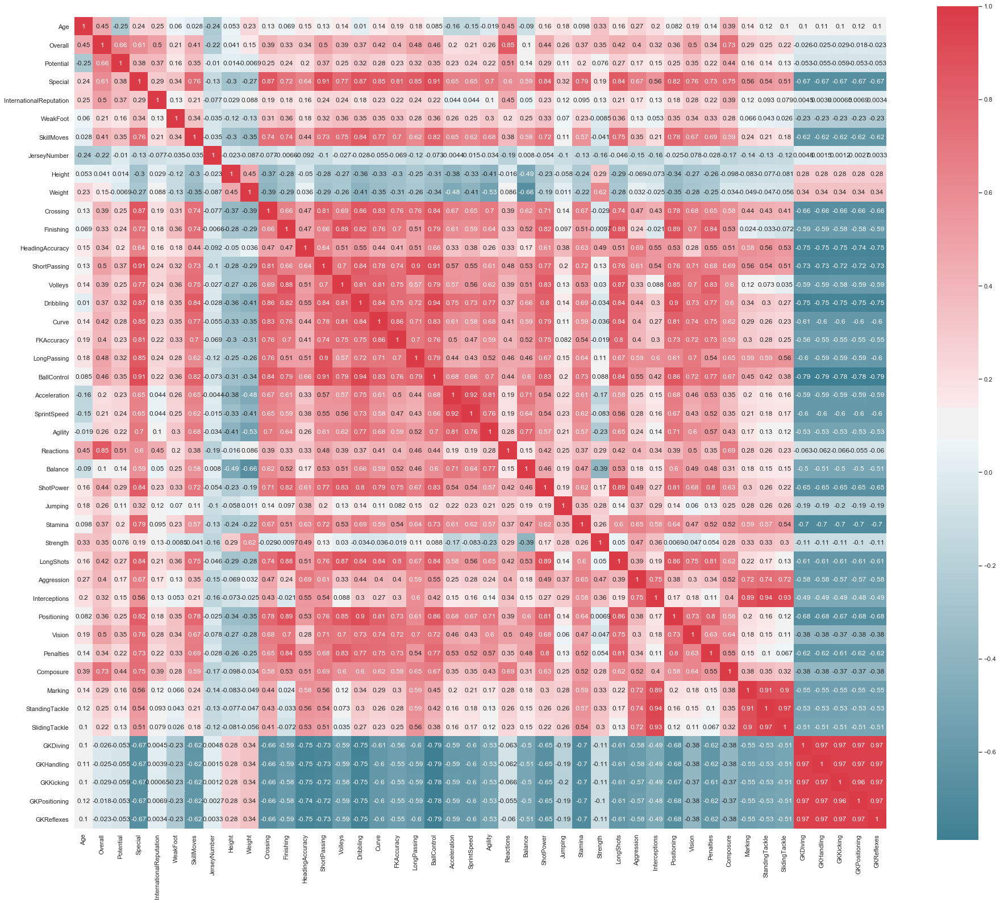

In [164]:
import matplotlib as mpl, matplotlib.pyplot as plt
corr = soccer.corr()

s , ax = plt.subplots( figsize =( 32 , 30 ) )

cmap = sns.diverging_palette( 220 , 10 , as_cmap = True )

s = sns.heatmap(corr, cmap = cmap, square=True, cbar_kws={ 'shrink' : .9 }, ax=ax, annot = True, annot_kws = { 'fontsize' : 12 })

In [165]:
soccer.columns

Index(['Age', 'Overall', 'Potential', 'Special', 'PreferredFoot',
       'InternationalReputation', 'WeakFoot', 'SkillMoves', 'WorkRate',
       'Position', 'JerseyNumber', 'Height', 'Weight', 'Crossing', 'Finishing',
       'HeadingAccuracy', 'ShortPassing', 'Volleys', 'Dribbling', 'Curve',
       'FKAccuracy', 'LongPassing', 'BallControl', 'Acceleration',
       'SprintSpeed', 'Agility', 'Reactions', 'Balance', 'ShotPower',
       'Jumping', 'Stamina', 'Strength', 'LongShots', 'Aggression',
       'Interceptions', 'Positioning', 'Vision', 'Penalties', 'Composure',
       'Marking', 'StandingTackle', 'SlidingTackle', 'GKDiving', 'GKHandling',
       'GKKicking', 'GKPositioning', 'GKReflexes'],
      dtype='object')

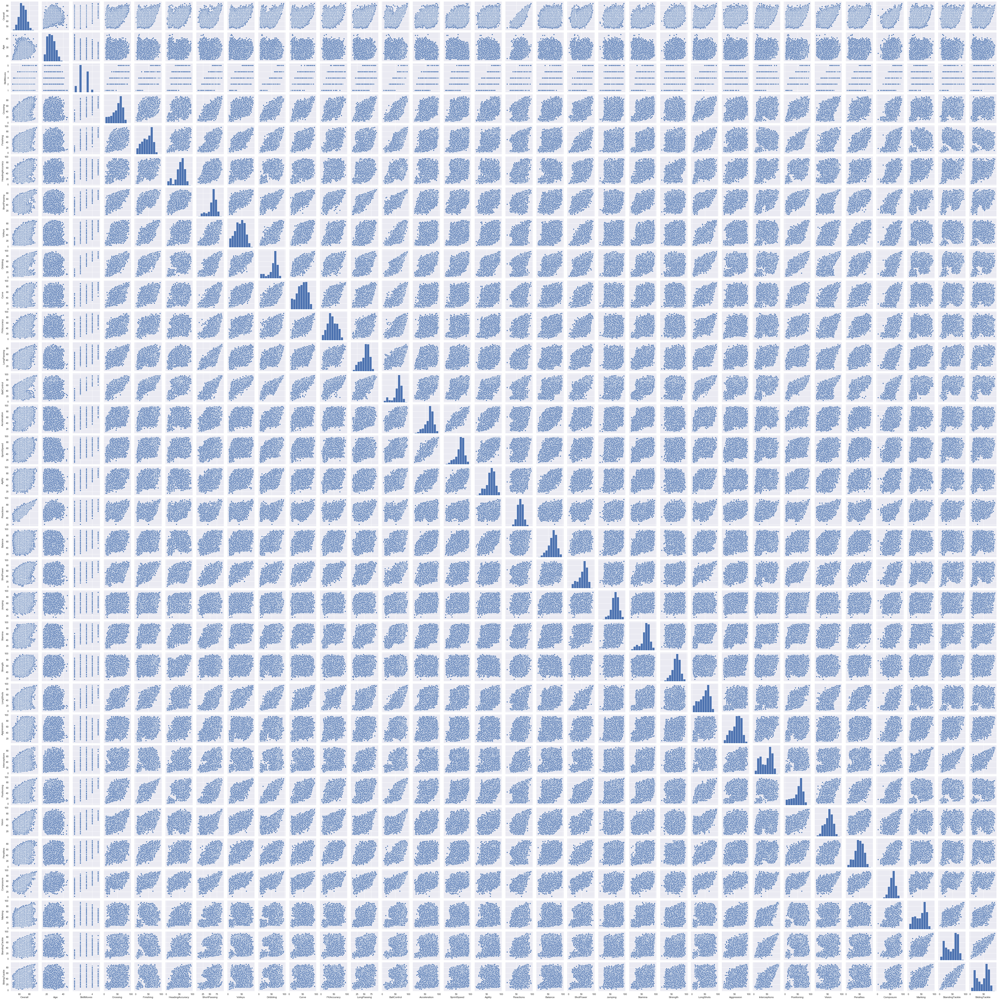

In [166]:
sns.set()
cols = ['Overall', 'Age', 'SkillMoves', 'Crossing', 'Finishing', 'HeadingAccuracy','ShortPassing','Volleys', 'Dribbling', 'Curve',
       'FKAccuracy', 'LongPassing', 'BallControl', 'Acceleration','SprintSpeed', 'Agility', 'Reactions', 'Balance', 'ShotPower',
       'Jumping', 'Stamina', 'Strength', 'LongShots', 'Aggression','Interceptions', 'Positioning', 'Vision', 'Penalties', 'Composure',
       'Marking', 'StandingTackle', 'SlidingTackle']
sns.pairplot(soccer[cols], height = 2)
plt.show()

In [167]:
soccer[['Position','Overall']].groupby(['Position'], as_index=True).mean()

,Overall
Position,
CAM,66.903967
CB,65.024747
CDM,66.313291
CF,65.824324
CM,63.729555
GK,64.603457
LAM,71.857143
LB,65.854766
LCB,69.240741


In [168]:
soccer[['PreferredFoot','Overall']].groupby(['PreferredFoot'], as_index=True).mean()

,Overall
PreferredFoot,
Left,66.801472
Right,66.083381


# Data Preprocessing

In [169]:
soccer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18207 entries, 0 to 18206
Data columns (total 47 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Age                      18207 non-null  int64  
 1   Overall                  18207 non-null  int64  
 2   Potential                18207 non-null  int64  
 3   Special                  18207 non-null  int64  
 4   PreferredFoot            18159 non-null  object 
 5   InternationalReputation  18159 non-null  float64
 6   WeakFoot                 18159 non-null  float64
 7   SkillMoves               18159 non-null  float64
 8   WorkRate                 18159 non-null  object 
 9   Position                 18147 non-null  object 
 10  JerseyNumber             18147 non-null  float64
 11  Height                   18159 non-null  float64
 12  Weight                   18159 non-null  float64
 13  Crossing                 18159 non-null  float64
 14  Finishing             

In [170]:
soccer.shape

(18207, 47)

In [171]:
soccer.isnull().sum()

Age                         0
Overall                     0
Potential                   0
Special                     0
PreferredFoot              48
InternationalReputation    48
WeakFoot                   48
SkillMoves                 48
WorkRate                   48
Position                   60
JerseyNumber               60
Height                     48
Weight                     48
Crossing                   48
Finishing                  48
HeadingAccuracy            48
ShortPassing               48
Volleys                    48
Dribbling                  48
Curve                      48
FKAccuracy                 48
LongPassing                48
BallControl                48
Acceleration               48
SprintSpeed                48
Agility                    48
Reactions                  48
Balance                    48
ShotPower                  48
Jumping                    48
Stamina                    48
Strength                   48
LongShots                  48
Aggression

In [172]:
soccer.dropna(axis=0,how='any',inplace=True)

In [173]:
soccer.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18147 entries, 0 to 18206
Data columns (total 47 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Age                      18147 non-null  int64  
 1   Overall                  18147 non-null  int64  
 2   Potential                18147 non-null  int64  
 3   Special                  18147 non-null  int64  
 4   PreferredFoot            18147 non-null  object 
 5   InternationalReputation  18147 non-null  float64
 6   WeakFoot                 18147 non-null  float64
 7   SkillMoves               18147 non-null  float64
 8   WorkRate                 18147 non-null  object 
 9   Position                 18147 non-null  object 
 10  JerseyNumber             18147 non-null  float64
 11  Height                   18147 non-null  float64
 12  Weight                   18147 non-null  float64
 13  Crossing                 18147 non-null  float64
 14  Finishing             

In [174]:
from sklearn.preprocessing import LabelEncoder
encoder=LabelEncoder()
soccer['PreferredFoot']=encoder.fit_transform(soccer['PreferredFoot'])

In [175]:
Dictionary = {
                    'ST':  '10',
                    'GK':   '1',
                    'CB':   '4',
                    'CM':   '6',
                    'LB':   '3',
                    'RB':   '2',
                    'RM':   '7',
                    'LM':   '8',
                    'CAM':  '15',
                    'CDM':  '16',
                    'RCB':  '17',
                    'LCB':  '18',
                    'LCM':  '19',
                    'RCM':  '20',
                    'LW':   '21',
                    'RW':   '22',
                    'RDM':  '23',
                    'LDM':  '24',
                    'LS' :  '25',
                    'RS' :  '26',
                    'RWB':  '27',
                    'LWB':  '28',
                    'CF' :  '9',
                    'RAM':  '11',
                    'LAM':  '12',
                    'RF' :  '13',
                    'LF' :  '14'}
soccer['Position'] = soccer.Position.map(Dictionary)

# Data spliting

In [176]:
features = [
        'Age', 'SkillMoves', 'Crossing', 'Finishing', 'HeadingAccuracy','ShortPassing','Volleys', 'Dribbling', 'Curve',
       'FKAccuracy', 'LongPassing', 'BallControl', 'Acceleration','SprintSpeed', 'Agility', 'Reactions', 'Balance', 'ShotPower',
       'Jumping', 'Stamina', 'Strength', 'LongShots', 'Aggression','Interceptions', 'Positioning', 'Vision', 'Penalties', 'Composure',
       'Marking', 'StandingTackle', 'SlidingTackle']


In [177]:
soccer.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18147 entries, 0 to 18206
Data columns (total 47 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Age                      18147 non-null  int64  
 1   Overall                  18147 non-null  int64  
 2   Potential                18147 non-null  int64  
 3   Special                  18147 non-null  int64  
 4   PreferredFoot            18147 non-null  int32  
 5   InternationalReputation  18147 non-null  float64
 6   WeakFoot                 18147 non-null  float64
 7   SkillMoves               18147 non-null  float64
 8   WorkRate                 18147 non-null  object 
 9   Position                 18147 non-null  object 
 10  JerseyNumber             18147 non-null  float64
 11  Height                   18147 non-null  float64
 12  Weight                   18147 non-null  float64
 13  Crossing                 18147 non-null  float64
 14  Finishing             

In [178]:
target = ['Overall']

In [179]:
X = soccer[features]

In [180]:
y = soccer[target]

In [181]:
X.iloc[2]

Age                26.0
SkillMoves          5.0
Crossing           79.0
Finishing          87.0
HeadingAccuracy    62.0
ShortPassing       84.0
Volleys            84.0
Dribbling          96.0
Curve              88.0
FKAccuracy         87.0
LongPassing        78.0
BallControl        95.0
Acceleration       94.0
SprintSpeed        90.0
Agility            96.0
Reactions          94.0
Balance            84.0
ShotPower          80.0
Jumping            61.0
Stamina            81.0
Strength           49.0
LongShots          82.0
Aggression         56.0
Interceptions      36.0
Positioning        89.0
Vision             87.0
Penalties          81.0
Composure          94.0
Marking            27.0
StandingTackle     24.0
SlidingTackle      33.0
Name: 2, dtype: float64

In [182]:
y

,Overall
0,94
1,94
2,92
3,91
4,91
...,...
18202,47
18203,47
18204,47
18205,47


In [183]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y ,test_size=0.2, random_state=30)

# Linear Regression model

In [184]:
model = LinearRegression()
model.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [185]:
predicted = model.predict(X_test)
predicted

array([[69.76350246],
       [67.79055368],
       [72.07730158],
       ...,
       [71.92019987],
       [48.88341425],
       [64.02982969]])

In [186]:
y_test.describe()

,Overall
count,3630.000000
mean,66.172452
std,6.974110
min,46.000000
25%,62.000000
50%,66.000000
75%,71.000000
max,91.000000


In [187]:
model.score(X_test,y_test)

0.7936809601964122

In [188]:
from sklearn import metrics
from sklearn.metrics import mean_squared_error
print('MSE', mean_squared_error(y_test,predicted))
print('R squared', metrics.r2_score(y_test,predicted))

MSE 10.032223250400177
R squared 0.7936809601964122


# Decision Tree model


In [189]:
from sklearn import tree
from sklearn.metrics import accuracy_score
model2 = DecisionTreeClassifier(max_depth=20)
model2.fit(X_train, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=20, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [190]:
classifier= tree.DecisionTreeClassifier()
classifier.fit(X_train,y_train)
y_prediction = model2.predict(X_test)
print ('Score:{}'.format(classifier.score(X_test,y_test)))

Score:0.16611570247933885


In [191]:
print('MSE', mean_squared_error(y_test,y_prediction))
print('R squared', metrics.r2_score(y_test,y_prediction))

MSE 7.937465564738292
R squared 0.8367609817967795
